# Star spectra with MCMC

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

from scipy.stats import norm


In [3]:

# constants

h = 6.67e-27           # cgs
k_B = 1.38e-16         # cgs
c = 2.99e10            # cm/s
parsec = 3.086e+18     # cm
T_sun = 5778           # K
R_sun = 6.96e10        # cm


def calzetti_extinction(wavelength, R_V=4.05):
    wavelength = np.atleast_1d(wavelength)
    k_lambda = np.zeros_like(wavelength)
    
    # UV to optical: 0.12 µm ≤ λ < 0.63 µm
    uv_opt_mask = (wavelength >= 0.12) & (wavelength < 0.63)
    lambda_uv_opt = wavelength[uv_opt_mask]
    k_lambda[uv_opt_mask] = (
        2.659 * (-2.156 + 1.509 / lambda_uv_opt - 0.198 / lambda_uv_opt**2 + 0.011 / lambda_uv_opt**3) + R_V
    )
    
    # Optical to NIR: 0.63 µm ≤ λ ≤ 2.2 µm
    opt_nir_mask = (wavelength >= 0.63) & (wavelength <= 2.2)
    lambda_opt_nir = wavelength[opt_nir_mask]
    k_lambda[opt_nir_mask] = (
        2.659 * (-1.857 + 1.040 / lambda_opt_nir) + R_V
    )

    return k_lambda[0] if wavelength.size == 1 else k_lambda

def model(w,T_star,R_star,EBmV,distance):
    """
    Perfect black body of temperature T and emitting surface R at distance d + dust extinction
    w in Armstrong
    T_star in K
    R_star in solar radii
    EBmV dimensionless
    distance in parsec
    returns observed specific flux in erg/s/cm^2/angstrom
    """
    w_cm = w * 1e-8         # wavelength converted from angstrom to cm
    R_star = R_star * R_sun
    distance = distance * parsec
    
    black_body = (2 * h * c**2) / (w_cm**5) * 1 / (np.exp((h * c) / (w_cm * k_B * T_star)) - 1)

    intrinsic_flux = 1e-8 * (R_star**2/distance**2) * np.pi * black_body

    w_micron = w * 1e-4 
    extinction = np.exp(-calzetti_extinction(w_micron,4.1) * EBmV)

    return intrinsic_flux * extinction



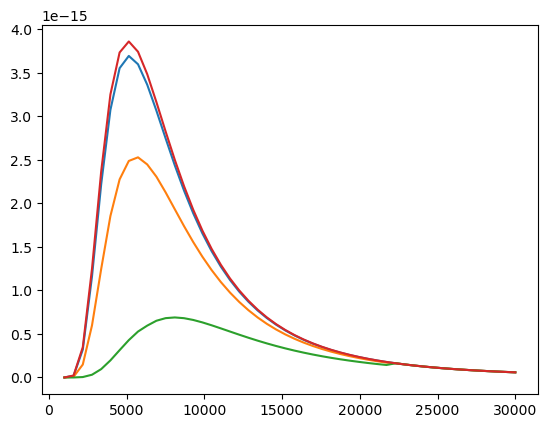

In [4]:
w = np.linspace(1000,30000)
for EBmV in [0.01,0.1,0.5,0]:
    plt.plot(w,model(w,T_star=5700,R_star=1,EBmV=EBmV,distance=1000))


<ErrorbarContainer object of 3 artists>

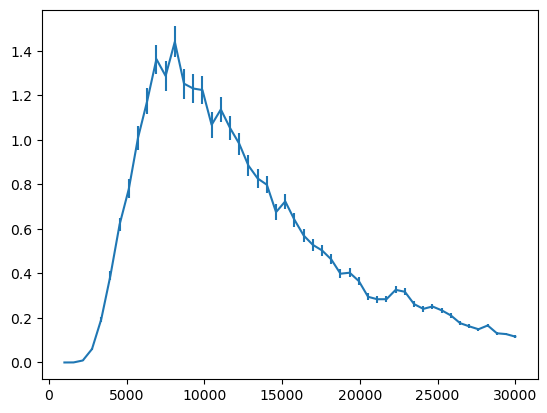

In [94]:
# build fake data adding noise to the spectrum
flux = model(w,T_star=5700,R_star=1,EBmV=0.5,distance=1000) * 1e15

noise = norm(loc=flux, scale=0.1*flux).rvs() 
data = flux+noise
errors = 0.1*flux

plt.errorbar(w,data,errors,linestyle='-')



## Maximum a posterior (MAP)

Bayes' Theorem:

$$ \mathrm{Posterior} = \frac{\mathrm{Likelihood}\times\mathrm{Prior}}{\mathrm{Evidence}} $$

$$p(M,\theta \,|\,D,I) = \frac{p(D\,|\,M,\theta,I)\,\times p(M,\theta\,|\,I)}{p(D\,|\,I)},$$

Assume $N$ measurements of the flux at $N$ different wavelenghts $\lambda_i$, where the uncertainty for each measurement is Gaussian with a known $\sigma_i$ (the flux error). The likelihood of one measurement is 

$$L \equiv p(x(\lambda_i)|\mu(\lambda_i),\sigma_i) = \frac{1}{\sigma_i\sqrt{2\pi}} \exp\left(\frac{-(x(\lambda_i)-\mu(\lambda_i))^2}{2\sigma_i^2}\right).$$

where $\mu(\lambda_i) = M(\theta,\lambda_i)$ is the model evaluated at each wavelength, for a given set of parameters.


and therefore the likelihood of all N measurements is

$$L \equiv p(\{x_i\}|\mu,\sigma_i) = \prod_{i=1}^N \frac{1}{\sigma_i\sqrt{2\pi}} \exp\left(\frac{-(x(\lambda_i)-\mu(\lambda_i))^2}{2\sigma_i^2}\right).$$


In [95]:

def LogLikelihood(params, data, errors, model):
    T_star, R_star, EBmV = params
    residual = data - model
    logL =np.sum( -0.5 * (residual / errors)**2 - np.log(np.sqrt(2 * np.pi) * errors**2) )
    return logL


def LogPrior(params): 
    T_star, R_star, EBmV = params[0],params[1],params[2]
    if T_star < 1e3 or T_star > 4e4 or R_star < 0.1 or R_star > 1e3 or EBmV < 0 or EBmV > 0.5:
        return -np.inf
    else:
        return 0  

def LogPosterior(params,data, errors, model):
    return LogPrior(params) + LogLikelihood(params, data, errors, model) 


In [99]:
print(model(w, 5700, 1, 0.5, distance=1000))

[1.85805588e-20 1.48454797e-19 4.94104893e-18 3.15187471e-17
 9.61437630e-17 1.96114035e-16 3.13610042e-16 4.28656816e-16
 5.27094839e-16 5.95002624e-16 6.51199949e-16 6.80979828e-16
 6.89043359e-16 6.80558690e-16 6.60252935e-16 6.32055255e-16
 5.99040166e-16 5.63510298e-16 5.27128465e-16 4.91053904e-16
 4.56063209e-16 4.22649806e-16 3.91102164e-16 3.61563471e-16
 3.34076210e-16 3.08614912e-16 2.85109884e-16 2.63464167e-16
 2.43565510e-16 2.25294671e-16 2.08531073e-16 1.93156552e-16
 1.79057745e-16 1.66127516e-16 1.54265720e-16 1.43379503e-16
 1.63075139e-16 1.49432456e-16 1.37168836e-16 1.26122761e-16
 1.16153984e-16 1.07140453e-16 9.89757150e-17 9.15667120e-17
 8.48319243e-17 7.86997860e-17 7.31073397e-17 6.79990880e-17
 6.33260123e-17 5.90447328e-17]


In [86]:
print(data[2])

[1.85805588e-06 1.48454797e-05 4.94104893e-04 3.15187471e-03
 9.61437630e-03 1.96114035e-02 3.13610042e-02 4.28656816e-02
 5.27094839e-02 5.95002624e-02 6.51199949e-02 6.80979828e-02
 6.89043359e-02 6.80558690e-02 6.60252935e-02 6.32055255e-02
 5.99040166e-02 5.63510298e-02 5.27128465e-02 4.91053904e-02
 4.56063209e-02 4.22649806e-02 3.91102164e-02 3.61563471e-02
 3.34076210e-02 3.08614912e-02 2.85109884e-02 2.63464167e-02
 2.43565510e-02 2.25294671e-02 2.08531073e-02 1.93156552e-02
 1.79057745e-02 1.66127516e-02 1.54265720e-02 1.43379503e-02
 1.63075139e-02 1.49432456e-02 1.37168836e-02 1.26122761e-02
 1.16153984e-02 1.07140453e-02 9.89757150e-03 9.15667120e-03
 8.48319243e-03 7.86997860e-03 7.31073397e-03 6.79990880e-03
 6.33260123e-03 5.90447328e-03]


In [87]:
def Metropolis_Hastings(data, N, params_init, proposal_std, prior_space, param_names):
    
    ndims = len(params_init)
    samples = [params_init]

    for i in range(N):
        current = samples[-1]
        proposal = current + np.random.normal(loc=0, scale=proposal_std, size=ndims)

        print(current)
        print(proposal)

        log_p_current = LogPosterior(current, data)
        log_p_proposal = LogPosterior(proposal, data)

        print(log_p_current)
        print(log_p_proposal)
        
        alpha = np.exp(log_p_proposal - log_p_current)

        #print(alpha)
        
        samples.append(proposal if np.random.rand() < alpha else current)
        
    return samples
    

In [91]:
LogPosterior([-1000,1,0.5],data,errors, model)

NameError: name 'errors' is not defined

In [89]:
params_init = [5000,1,0.5]
proposal_std = [1000,0.5,0.05]
prior_space = [[3000,7000],[0.1,3],[0.3,0.7]]

samples = Metropolis_Hastings(data,500,params_init=params_init,proposal_std=proposal_std,prior_space=prior_space,param_names=['T','R','EBmV'])

[5000, 1, 0.5]
[6.04408008e+03 1.15233864e+00 5.04796996e-01]


TypeError: LogPosterior() missing 2 required positional arguments: 'errors' and 'model'

In [17]:
T = [s[0] for s in samples]
R = [s[1] for s in samples]
EBmV = [s[2] for s in samples]

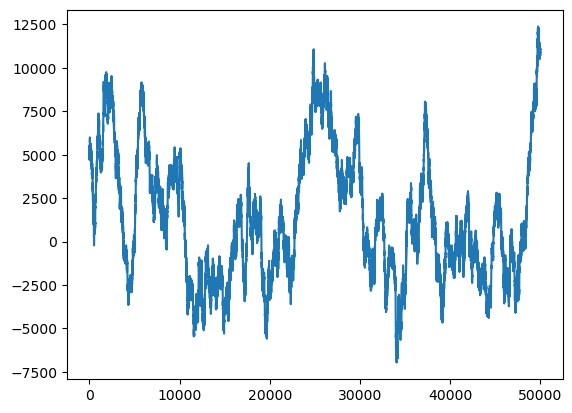

In [18]:
plt.plot(np.arange(0,len(T),1),T)

In [181]:
def Animated_Metropolis_Hastings(data, N, params_init, proposal_std, prior_space, param_names):
    from IPython.display import HTML, display
    import matplotlib.pyplot as plt
    import numpy as np
    from matplotlib.animation import FuncAnimation

    ndims = len(params_init)
    samples = [params_init]

    fig, axes = plt.subplots(ndims - 1, ndims - 1, figsize=(2 * ndims, 2 * ndims))
    scatters = [[None for _ in range(ndims - 1)] for _ in range(ndims - 1)]  # store scatter plots

    # Configure axes
    for i in range(ndims - 1):
        for j in range(ndims - 1):
            ax = axes[i, j]
            if i < j:
                ax.set_visible(False)
            else:
                ax.set_xlim(prior_space[j][0], prior_space[j][1])
                ax.set_ylim(prior_space[i + 1][0], prior_space[i + 1][1])
                if j == 0:
                    ax.set_ylabel(param_names[i + 1])
                if i == ndims - 2:
                    ax.set_xlabel(param_names[j])

    plt.tight_layout()

    # Initialize scatter plots for lower triangle
    for i in range(1, ndims):
        for j in range(i):
            scatters[i - 1][j] = axes[i - 1][j].scatter([], [], s=2, c='grey')

    def init():
        for i in range(1, ndims):
            for j in range(i):
                scatters[i - 1][j].set_offsets(np.empty((0, 2)))
        return [scatters[i - 1][j] for i in range(1, ndims) for j in range(i)]

    def update(frame):
        current = samples[-1]
        proposal = current + np.random.normal(loc=0, scale=proposal_std, size=ndims)

        log_p_current = LogPosterior(current, data)
        log_p_proposal = LogPosterior(proposal, data)

        alpha = min(1, np.exp(log_p_proposal - log_p_current))
        samples.append(proposal if np.random.rand() < alpha else current)

        path = np.array(samples)
        for i in range(1, ndims):
            for j in range(i):
                scatters[i - 1][j].set_offsets(path[:, [j, i]])

        return [scatters[i - 1][j] for i in range(1, ndims) for j in range(i)]

    ani = FuncAnimation(
        fig, update, init_func=init,
        frames=N, interval=100, blit=False
    )

    display(HTML(ani.to_jshtml()))
    plt.close()

    return samples




In [183]:
params_init = [5000,1,0.5]
proposal_std = [100,0.05,0.01]
prior_space = [[3000,7000],[0.1,3],[0.3,0.7]]

samples = Animated_Metropolis_Hastings(data,1000,params_init=params_init,proposal_std=proposal_std,prior_space=prior_space,param_names=['T','R','EBmV'])



/tmp/ipykernel_28130/2990679536.py:47: RuntimeWarning: invalid value encountered in scalar subtract
  alpha = min(1, np.exp(log_p_proposal - log_p_current))
Animation size has reached 20989067 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [70]:
print(LogPosterior([5700,R_sun,0.5],data))

-255299.58102628367


In [71]:
print(LogPosterior([5000,R_sun,0.5],data))

-608062.7425976109


In [72]:
print(LogPosterior([5900,R_sun,0.5],data))

-150240.2294487485


In [95]:
print(np.empty((0,3)[1]))

[43.55555556 43.55555556 43.55555556]


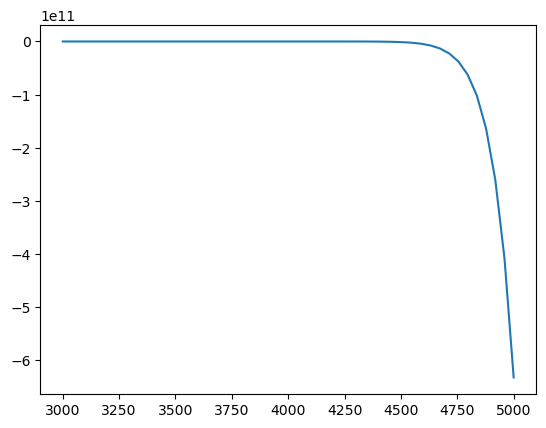

In [78]:
log_p = []
for T in np.linspace(3000,9000):
    #print(LogPosterior([T,R_sun,0.5,1000],data))
    log_p.append(LogPosterior([T,R_sun,0.5],data))


plt.plot(np.linspace(3000,5000),log_p)

In [9]:
params_init = [5000,1,0.5]
print(params_init)

[5000, 1, 0.5]


In [16]:
import emcee
import numpy as np

# Number of parameters
ndim = 3
nwalkers = 6
burn = 1000
nsteps = 10000

# Starting positions: small Gaussian noise around params_init
np.random.seed(0)
starting_guesses = params_init + 1e-4 * np.random.randn(nwalkers, ndim)

# Use EnsembleSampler with correct args
sampler = emcee.EnsembleSampler(nwalkers, ndim, LogPosterior, args=[data])

# Run MCMC
sampler.run_mcmc(starting_guesses, nsteps, progress=True)

# Extract trace, discard burn-in, and flatten
emcee_trace = sampler.get_chain(discard=burn, flat=True)

print("done")

100%|████████| 10000/10000 [00:08<00:00, 1119.35it/s]

done


In [25]:
samples[:,2,1]

array([0.99998486, 0.99998486, 0.99998486, ..., 0.99998486, 0.99998486,
       0.99998486])

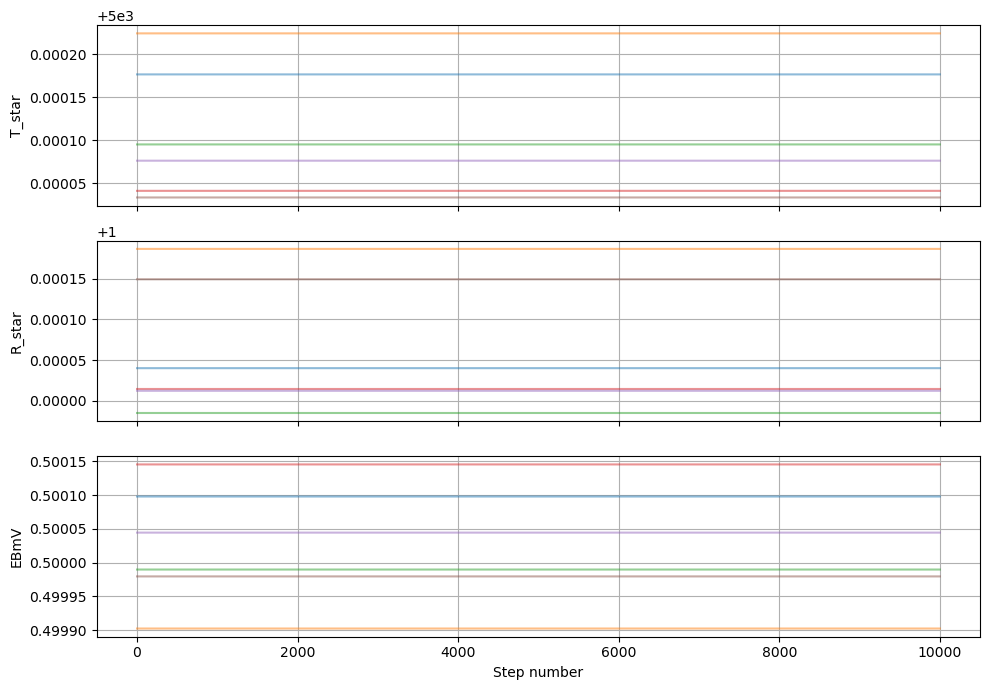

In [22]:
labels = ["T_star", "R_star", "EBmV"]

fig, axes = plt.subplots(ndim, figsize=(10, 7), sharex=True)
samples = sampler.get_chain()

for i in range(ndim):
    ax = axes[i]
    #for walker in range(nwalkers):
    ax.plot(samples[:, walker, i], alpha=0.5)
    ax.set_ylabel(labels[i])
    ax.grid()

axes[-1].set_xlabel("Step number")
plt.tight_layout()
plt.show()